In [ ]:
from IPython.core.pylabtools import figsize
%pip install pycocoevalcap

In [11]:
import json
import torch
import numpy as np

from tqdm import tqdm
from datasets import Dataset
from datasets import load_dataset
from src.vis2 import make_domain_plots
from src.visualization import make_overall_plots
from matplotlib import pyplot as plt
from src.metrics import count_images_by_treshold
from pycocoevalcap.cider.cider import Cider
from pycocoevalcap.rouge.rouge import Rouge
from transformers import LlavaForConditionalGeneration, AutoProcessor
from transformers import BlipProcessor, BlipForConditionalGeneration

%config InlineBackend.figure_format = 'retina'

### Сравнение модели-эксперта BLIP и LLaVA 1.5

В качестве моделей для сравнения c __LLaVA__ я выбрал __BLIP__.

__Архитектура__ +

BLIP  строится на основе нескольких компонентов: визуальный кодировщик на основе трансформера ViT, текстовы кодировщик (BERT) и кросс-модальный модуль для объединения представлений текстов и изображений.  LLaVA-1.5 также использует визуальный кодировщик (CLIP ViT-L/14), проекционный слой, который проецирует представления изображений на представления токенов, пригодных для подачи в языковую модель. LLM в принципе может выступать любая модель, но авторы использовали LLaMA-2.

__Решаемая задача__

BLIP - это мультимодальная модель общего назначения, которая может решать достаточно широкий спектр задач captioning, VQA, Grounding. LLaVA

BLIP — это мультимодальный фреймворк общего назначения. Он решает широкий спектр задач: генерация описаний к изображениям, визуальный вопрос-ответ, поиск по изображению или тексту, а также общие задачи мультисенсорного понимания. Это фундаментальная модель для совместного представления изображений и текста, подходящая как для генеративных, так и для дискриминативных задач.

LLaVA 1.5 фокусируется на задаче инструкционного визуального диалога. Это не просто генерация описания, а способность следовать визуальным инструкциям и вести диалог по изображению. Благодаря более точному отображению изображений в пространство языка, LLaVA 1.5 лучше справляется с задачами мультимодального reasoning’а, объяснением сложных сцен, чтением текста на изображениях, обсуждением деталей и сравнением объектов. Это делает её ближе к полноценному визуальному ассистенту.

__Данные в обучении__ +

__BLIP__ использует множество датасетов для обучения: __LAION__, __Conceptual Captions__, __COCO__, _NoCaps_ и т.д. В процессе обучения авторы применяли метод бутсраппинга: использовали слабые модели для генерации псевдоразметки, которая, затем, фильтровалась и уточнялась. Это позволило обучить BLIP на слабосвязанных парах текс-изображение. Авторы LLaVA 1.5 обучали модель на визуальных инструкциях, собранных при помощи ChatGPT-4, получали автоматические описания, к которым далее генерировались вопросы и ответы. Модель дообучалась на парах в формате диалога. Модель даже позволяет отвечать на вопросы об относительном положении предметах на изображегнии.

__Область применения__ +

BLIP подходит для задач, где нужно глубоко понимать и анализировать изображение в связке с текстом: captioning, VQA, grounding. Модель можно использовать и как генератор и как классифкатор в качестве в вспомогательной модели. LLaVA, наверное можно считать ближайшим предком современных мультимодальных моделей, модель выглядит как типичный чат-бот с возможностью обработки изображений. Основная область применения — это ассистенты, способные интерпретировать изображения, отвечать на вопросы, вести диалог по визуальному контексту. С этой моделью обычный человек может взаимодействовать напрямую, поэтому ее можно использовать как полноценного помощника.

__Универсальность__

BLIP, особенно в версии 2, — это крайне универсальный фреймворк. Он предназначен не только для генерации, но и для оценки, поиска и совместного кодирования изображений и текста. Его архитектура легко масштабируется и интегрируется с разными LLM, а также может быть адаптирована к специализированным задачам в разных доменах.

LLaVA 1.5 более узко специализирована на визуальном диалоге, но её сила в другом: она даёт простой способ добавить «зрение» в любую LLM. Благодаря модульной структуре (замороженный LLM + проекция), она легко дообучается и адаптируется под различные задачи без необходимости дорогостоящего обучения всей модели. Она менее универсальна в классическом смысле (например, не так хорошо подходит для image retrieval), но невероятно эффективна и гибка в области интерактивных визуальных агентов.



### BLIP Image Captioning

In [21]:
blip_model = "Salesforce/blip-image-captioning-base"

blip_processor = BlipProcessor.from_pretrained(blip_model)
blip_model = BlipForConditionalGeneration.from_pretrained(blip_model)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [26]:
def generate_caption_blip(image) -> str:
    blip_inputs = blip_processor(image, return_tensors="pt")
    outputs = blip_model.generate(**blip_inputs)
    caption = blip_processor.decode(outputs[0], skip_special_tokens=True)
    return caption

### Промпт для LLaVA

In [37]:
model_id = "llava-hf/llava-1.5-7b-hf"

model = LlavaForConditionalGeneration.from_pretrained(
    model_id,
    torch_dtype=torch.float16,
    device_map="mps"
)

processor = AutoProcessor.from_pretrained(model_id)

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [41]:
def generate_caption_llava(image) -> str:
    conversation = [
        {
            "role": "user",
            "content": [
                {"type": "image"},
                {"type": "text", "text": "Describe this image in one short sentence."},
            ],
        },
    ]

    prompt = processor.apply_chat_template(
        conversation=conversation,
        tokenize=False,
        add_generation_prompt=True
    )

    inputs = processor(
        text=prompt,
        images=image,
        return_tensors="pt",
        padding=True
    )

    inputs = {k: v.to(model.device) for k, v in inputs.items()}

    generate_ids = model.generate(
        **inputs,
        max_new_tokens=200,
        do_sample=True,
        temperature=0.1
    )

    response = processor.batch_decode(generate_ids, skip_special_tokens=True,
                                      clean_up_tokenization_spaces=False)[0]

    return response


### Генерируем Captions

Для генерации подписей к фото я возьму датасет NoCaps

In [6]:
ds = load_dataset("HuggingFaceM4/NoCaps", split="validation")

In [28]:
blip_captions = []

for i, row in tqdm(enumerate(ds)):
    caption = generate_caption_blip(row["image"])
    blip_captions.append(caption)

4500it [38:14,  1.96it/s]


In [36]:
blip_captions_dict = []
for i, caption in enumerate(blip_captions):
    blip_captions_dict.append({
        "idx": i,
        "caption": caption,
    })

Dataset.from_list(blip_captions_dict).save_to_disk("./resources/blip-generated-captions")

Saving the dataset (0/1 shards):   0%|          | 0/4500 [00:00<?, ? examples/s]

In [42]:
llava_captions = []
for i, row in tqdm(enumerate(ds)):
    caption = generate_caption_llava(row["image"])
    llava_captions.append(caption)

4500it [2:41:07,  2.15s/it]


In [46]:
def extract_caption(caption_to_map: str) -> str:
    return caption_to_map.split("ASSISTANT: ")[1]

In [57]:
mapped_llava_captions = list(map(extract_caption, llava_captions))

In [58]:
mapped_llava_captions[:10]

['A young boy wearing a white shirt and shorts is standing on a sidewalk.',
 'An elephant with a red basket on its back.',
 'A table with a Starbucks cup, Red Bull, and other items.',
 'A bunch of green herbs are displayed on a shelf.',
 'A blue and white bird perched on a tree branch.',
 'A row of violins are hanging on a wall.',
 'A cake with a princess theme on top.',
 'A man in a wheelchair is racing down the street.',
 'A white garage with a door that is open.',
 'A man is riding a Yamaha jet ski in the ocean.']

In [59]:
llava_captions_dict = []
for i, caption in enumerate(mapped_llava_captions):
    llava_captions_dict.append({
        "idx": i,
        "caption": caption,
    })

In [61]:
Dataset.from_list(llava_captions_dict).save_to_disk("./resources/llava-generated-captions")

Saving the dataset (0/1 shards):   0%|          | 0/4500 [00:00<?, ? examples/s]

### Оценка качества

NoCaps — это датасет для оценки качества генерации описаний к изображениям (image captioning) в условиях, когда модели не хватает предварительных знаний о видах объектов, встречающихся на изображения. Этот датасет был создан с целью проверить способность моделей генерировать осмысленные описания для незнакомых объектов, то есть тех, которые не встречались в обучающих данных.

Изображения взяты из открытого набора данных Open Images и содержат три подмножества:

__In-domain__: объекты, часто встречающиеся в обучающих наборах для image captioning (например, люди, животные).

__Near-domain__: менее распространённые объекты, но всё ещё близкие к обучающим данным.

__Out-of-domain__: полностью новые объекты, которых нет в традиционных наборах данных (например, роботы, специфические приборы и т.д.).

Датасет является по сути бенчмарком и перекрываеся частично с датасетом COCO, на котором обучался BLIP, по этому по идее для него релевантны понятия доменных, околодомменных и недоменных изображений, LLaVA как я упоминал в начале ноута обучалась совсем иначе (однако нельзя исключать того, что визуальный кодировщик все же видел изображения из того же COCO), для нее все три категории должны быть как бы недоменными и кажется она должна демонстрировать более сильную обобщающую способность.

Будем измерять метрику __CIDEr__: Consensus-based Image Description Evaluation


In [4]:
with open('nocap_val_4500_captions.json', 'r', encoding='utf-8') as f:
    nocap_captions = json.load(f)

nocap_images_metadata = nocap_captions.get("images")
nocap_images_metadata_dataset = Dataset.from_list(nocap_images_metadata)

domain_map = {row["open_images_id"]: row["domain"] for row in nocap_images_metadata_dataset}

In [7]:
def add_label(example):
    example["domain"] = domain_map.get(example["image_open_images_id"], None)
    return example

ds_with_domains = ds.map(add_label)

In [8]:
blip_captions_dataset = Dataset.load_from_disk("./resources/blip-generated-captions")
llava_captions_dataset = Dataset.load_from_disk("./resources/llava-generated-captions")

domains = [
    "in-domain",
    "near-domain",
    "out-domain",
]

domain_metrics = {}

for domain in tqdm(domains):

    metrics_map = {}

    references = {}
    blip_hypothesis = {}
    llava_hypothesis = {}

    matching_indices = [i for i, x in enumerate(ds_with_domains) if x["domain"] == domain]

    gt_ds_domain_photos = ds_with_domains.select(matching_indices)
    blip_domain_photos = blip_captions_dataset.select(matching_indices)
    llava_domain_photos = llava_captions_dataset.select(matching_indices)

    for bl, ll, gt_captions in zip(blip_domain_photos, llava_domain_photos, gt_ds_domain_photos.select_columns(["annotations_captions"])):
        references[f"img{bl["idx"]}"] = gt_captions["annotations_captions"]
        blip_hypothesis[f"img{bl["idx"]}"] = [bl["caption"]]
        llava_hypothesis[f"img{bl["idx"]}"] = [ll["caption"]]

    scorers = [
        (Rouge(), "ROUGE-L-BLIP"),
        (Rouge(), "ROUGE-L-LLaVA"),
        (Cider(), "CIDEr-BLIP"),
        (Cider(), "CIDEr-LLaVA"),
    ]

    for scorer, method_name in tqdm(scorers, desc="calculating metrics"):
        if "blip" in method_name.lower():
            score, scores_per_sample = scorer.compute_score(references, blip_hypothesis)
        elif "llava" in method_name.lower():
            score, scores_per_sample = scorer.compute_score(references, llava_hypothesis)
        else:
            raise RuntimeError(f"Unknown method {method_name}")

        metrics_map[method_name] = {
            "score": score,
            "scores_per_sample": scores_per_sample,
        }

    domain_metrics[domain] = metrics_map

100%|██████████| 3/3 [01:35<00:00, 31.90s/it]


Overall Metrics

| Model | CIDEr (in-domain)  | CIDEr (near-domain) | CIDEr (out-of-domain) |
|-------|--------------------|---------------------|-----------------------|
| BLIP  | 0.6512322953166114 | 0.6467658644373379  | 0.6271376221388123    |
| LLaVA | 0.7502310840160232 | 0.8009773337024172  | 0.8085796211470544    |

В качестве порога хорошего качества подписей к изображениям я выбрал $\text{CIDEr}=0.5$

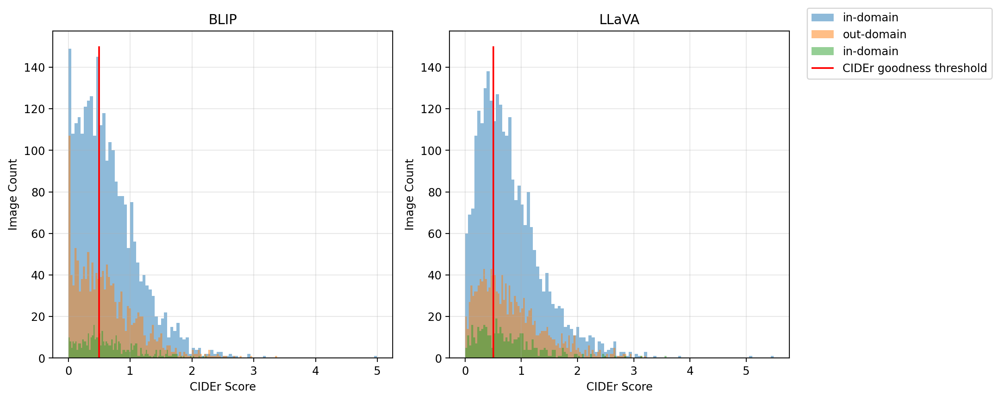

In [29]:
make_overall_plots(domain_metrics)

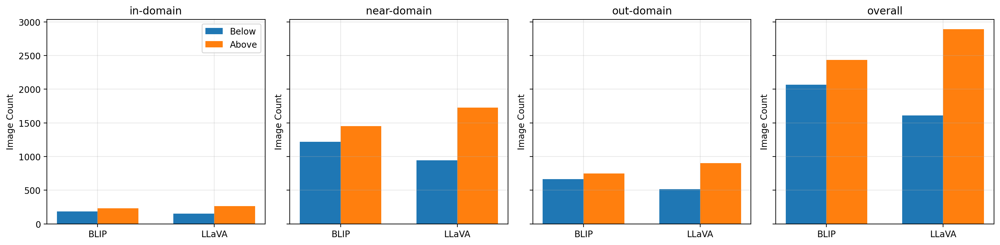

In [50]:
agg_metrics = count_images_by_treshold(domain_metrics, 0.5)

scopes = ['in-domain', 'near-domain', 'out-domain', 'overall']
models = ['BLIP', 'LLaVA']
categories = ['above', 'below']

fig, axs = plt.subplots(1, 4, figsize=(16, 4), sharey=True)

for i, scope in enumerate(scopes):
    ax = axs[i]
    values = []

    for model in models:
        model_data = agg_metrics[model][scope]
        values.append([model_data['below'], model_data['above']])

    values = np.array(values)

    x = np.arange(len(models))
    bar_width = 0.35

    ax.bar(x - bar_width/2, values[:, 0], width=bar_width, label='Below')
    ax.bar(x + bar_width/2, values[:, 1], width=bar_width, label='Above')

    ax.set_xticks(x)
    ax.set_xticklabels(models)
    ax.set_title(scope)
    ax.set_ylabel('Image Count')

    ax.grid(True, alpha=0.3)

    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()

В каждом домене и в среднем LLaVA перформит лучше BLIP при заданных параметрах

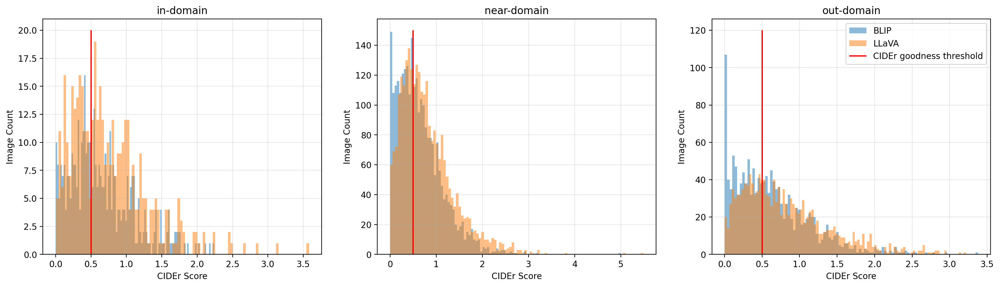

In [30]:
make_domain_plots(domain_metrics)

Правые хвосты у LLaVA смещены чуть правее относительно BLIP, кепшены лавы получают более высокий скор

### Черри-пики

In [57]:
metrics_map = {}

references = {}
blip_hypothesis = {}
llava_hypothesis = {}

gt_captions = ds_with_domains.select_columns(["annotations_captions"])

for bl, ll, gt_captions in zip(blip_captions_dataset, llava_captions_dataset, gt_captions):
    references[f"img{bl["idx"]}"] = gt_captions["annotations_captions"]
    blip_hypothesis[f"img{bl["idx"]}"] = [bl["caption"]]
    llava_hypothesis[f"img{bl["idx"]}"] = [ll["caption"]]

_, blip_per_image_scores =  Cider().compute_score(references, blip_hypothesis)
_, llava_per_image_scores =  Cider().compute_score(references, llava_hypothesis)

In [108]:
blip_bad_captions_idx = np.where(blip_per_image_scores <= 0.1)
blip_good_captions_idx = np.where(blip_per_image_scores > 3)

blip_bad_captions = np.array(blip_captions_dataset["caption"])[blip_bad_captions_idx]
blip_good_captions = np.array(blip_captions_dataset["caption"])[blip_good_captions_idx]

In [107]:
llava_bad_captions_idx = np.where(llava_per_image_scores <= 0.1)
llava_good_captions_idx = np.where(llava_per_image_scores > 3)

llava_bad_captions = np.array(llava_captions_dataset["caption"])[llava_bad_captions_idx]
llava_good_captions = np.array(llava_captions_dataset["caption"])[llava_good_captions_idx]

### BLIP Good Captions

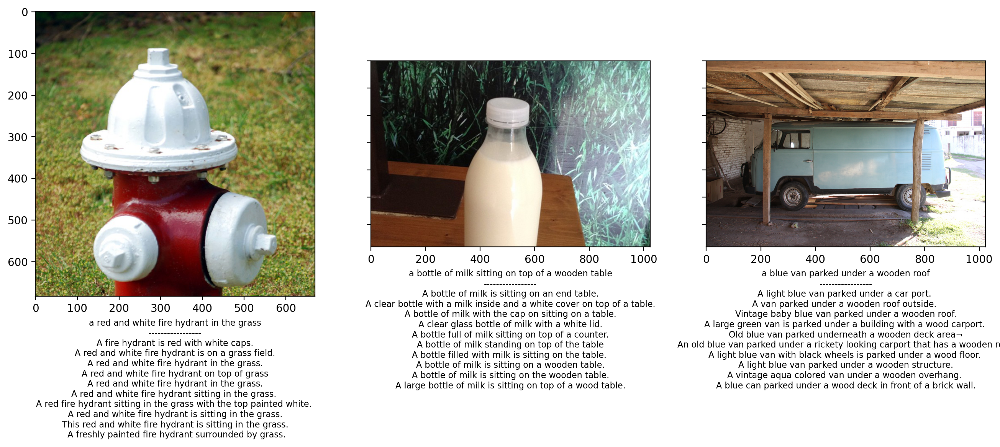

In [142]:
b = ds.select(indices=blip_good_captions_idx[0]).select_columns(["image", "annotations_captions"])

fig, axs = plt.subplots(ncols=len(b), nrows=1, figsize=(16, 4 * len(b)), sharey=True)
axs = axs.flatten()

for ax, k, blip_caption in zip(axs, b, blip_good_captions):
    ax.imshow(k["image"])
    ax.set_xlabel(blip_caption + "\n-----------------\n" + "\n".join(k["annotations_captions"]), fontsize=8)

plt.show()

### BLIP Bad Captions

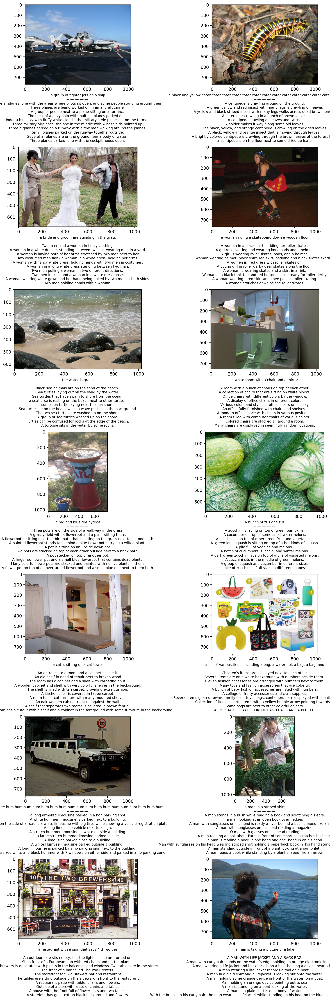

In [140]:
b = ds.select(indices=blip_bad_captions_idx[0][:14]).select_columns(["image", "annotations_captions"])

fig, axs = plt.subplots(ncols=2, nrows=7, figsize=(12, 32), constrained_layout=True)
axs = axs.flatten()

for ax, k, blip_caption in zip(axs, b, blip_bad_captions):
    ax.imshow(k["image"])
    ax.set_xlabel(blip_caption + "\n-----------------\n" + "\n".join(k["annotations_captions"]), fontsize=8)

plt.show()

### LLaVA Good Captions

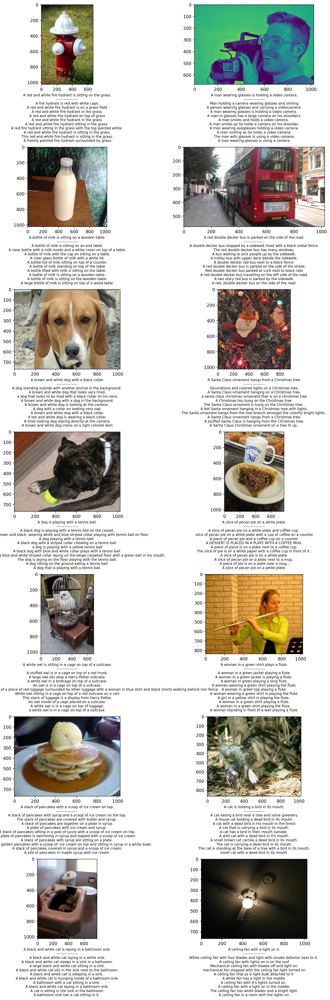

In [134]:
b = ds.select(indices=llava_good_captions_idx[0]).select_columns(["image", "annotations_captions"])

fig, axs = plt.subplots(ncols=2, nrows=7, figsize=(12, 32), constrained_layout=True)
axs = axs.flatten()

for ax, k, llava_caption in zip(axs, b, llava_good_captions):
    ax.imshow(k["image"])
    ax.set_xlabel(llava_caption + "\n-----------------\n" + "\n".join(k["annotations_captions"]), fontsize=8)

plt.show()

### LLaVA bad examples

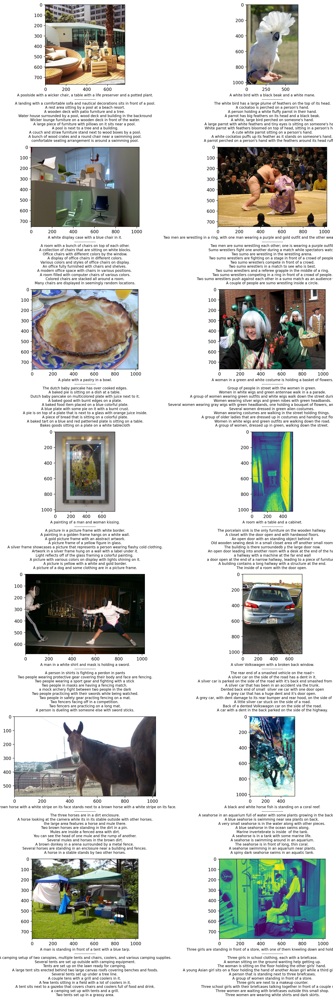

In [143]:
b = ds.select(indices=llava_bad_captions_idx[0][:14]).select_columns(["image", "annotations_captions"])

fig, axs = plt.subplots(ncols=2, nrows=7, figsize=(12, 32), constrained_layout=True)
axs = axs.flatten()

for ax, k, llava_caption in zip(axs, b, llava_bad_captions):
    ax.imshow(k["image"])
    ax.set_xlabel(llava_caption + "\n-----------------\n" + "\n".join(k["annotations_captions"]), fontsize=8)

plt.show()